# Описание проекта

Вы работаете в фотохостинге для профессиональных фотографов «Со Смыслом» (“With Sense”). 

Ваши пользователи размещают свои фотографии на хостинге и сопровождают их полным описанием: указывают место съёмок, модель камеры и т. д. Отличительная особенность сервиса — описание: его может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала.

описание выглядит так:
- A hiker poses for a picture in front of stunning mountains and clouds.

Ваш отдел занимается экспериментом по разработке поиска референсных фотографий для фотографов. Суть поиска заключается в следующем: пользователь сервиса вводит описание нужной сцены. Например, такое:
- A man is crossing a mountain pass on a metal bridge.

Сервис выводит несколько фотографий с такой же или похожей сценой.

Чтобы эксперимент получил право на жизнь, нужно защитить его перед руководителем компании. Для защиты необходимо презентовать так называемый PoC (Proof of Concept, Проверка концепции) — продемонстрировать, что такой проект практически осуществим. Вам поручено разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно выбрать лучшую  модель, которая получит векторное представление изображения, векторное
представление текста, а на выходе выдаст число от 0 до 1 — и покажет, насколько текст и картинка подходят друг другу. 

На основе лучшей модели можно будет собрать предварительную версию продукта, которую вы покажете руководителю компании.

# Юридические ограничения

В некоторых странах, где работает компания With Sense, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно, текстов, изображений, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16-ти лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

- This image is unavailable in your country in compliance with local laws.

Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому необходимо очистить данные от проблемного контента. Во время тестирования модели при появлении в запросе “вредного” контента должен отображаться дисклеймер. 

# Описание данных

В файле train_dataset.csv находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.
В папке train_images содержатся изображения для тренировки модели.
В файле CrowdAnnotations.tsv  — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
Имя файла изображения.
Идентификатор описания.
Доля людей, подтвердивших, что описание соответствует изображению.
Количество человек, подтвердивших, что описание соответствует изображению.
Количество человек, подтвердивших, что описание не соответствует изображению.
В файле ExpertAnnotations.tsv  — данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:
Имя файла изображения.
Идентификатор описания.
3, 4, 5 — оценки трёх экспертов. 
Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.      
В файле test_queries.csv находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.
В папке test_images содержатся изображения для тестирования модели.
При решении задачи используйте только один фреймворк  Pytorch или Keras.

# Шаг 1. Загрузите данные и проведите исследовательский анализ данных

In [1]:
import os
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import pickle

import nltk
from nltk.stem import WordNetLemmatizer
import re
from nltk.corpus import stopwords
from PIL import Image

from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Flatten, Dropout, BatchNormalization
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax, Nadam, RMSprop
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow import keras
import tensorflow as tf
import keras_nlp

import torch

from tqdm import tqdm
from tqdm import notebook

import transformers

from sklearn.model_selection import GroupShuffleSplit, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyRegressor
from lightgbm import LGBMRegressor
from sklearn.pipeline import make_pipeline
from sklearn.svm import LinearSVR
from sklearn.metrics import mean_absolute_error, mean_squared_error, root_mean_squared_error
from sklearn.preprocessing import StandardScaler

C:\Users\Dmitriy\anaconda3\envs\toxic\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
warnings.filterwarnings('ignore')

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

ROOT_FOLDER =  'to_upload'
TRAIN_IMAGE_FOLDER = os.path.join(ROOT_FOLDER, 'train_images')
TEST_IMAGE_FOLDER = os.path.join(ROOT_FOLDER, 'test_images')

#BLOCK_WORDS
BLOCK = ['teenage', 'baby', 'child', 'teenager', 'girl', 'boy', 'kid'] 

RANDOM_STATE = 42

np.random.seed(RANDOM_STATE)
tf.random.set_seed(RANDOM_STATE)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Dmitriy/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\Dmitriy/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Dmitriy/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\Dmitriy/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


Обучающий датасет

In [3]:
data_train = pd.read_csv(os.path.join(ROOT_FOLDER, 'train_dataset.csv'))

In [4]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [5]:
data_train.head()

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [6]:
data_train.describe()

,image,query_id,query_text
count,5822,5822,5822
unique,1000,977,977
top,3364151356_eecd07a23e.jpg,2600867924_cd502fc911.jpg#2,"Two dogs , one brown and white and one black a..."
freq,10,34,34


In [7]:
len(data_train['image'].unique())

1000

Датасет для тестирования

In [8]:
data_test_queries = pd.read_csv(os.path.join(ROOT_FOLDER, 'test_queries.csv'), index_col=[0], sep='|')

In [9]:
data_test_queries.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


In [10]:
data_test_queries.describe()

,query_id,query_text,image
count,500,500,500
unique,500,500,100
top,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
freq,1,1,5


In [11]:
data_test_queries.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


In [12]:
len(data_test_queries['image'].unique())

100

Данные по соответствию изображения и описания, полученные с помощью краудсорсинга.

In [13]:
data_crowd_annotations = pd.read_csv(os.path.join(ROOT_FOLDER, 'CrowdAnnotations.tsv'), sep='\t', 
                                     names=['image', 'query_id', 'share_pos', 'count_pos', 'count_neg'])

In [14]:
data_crowd_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   image      47830 non-null  object 
 1   query_id   47830 non-null  object 
 2   share_pos  47830 non-null  float64
 3   count_pos  47830 non-null  int64  
 4   count_neg  47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [15]:
data_crowd_annotations.head()

,image,query_id,share_pos,count_pos,count_neg
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


In [16]:
data_crowd_annotations.describe()

,share_pos,count_pos,count_neg
count,47830.000000,47830.000000,47830.000000
mean,0.068786,0.208488,2.820155
std,0.207532,0.628898,0.656676
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,3.000000
50%,0.000000,0.000000,3.000000
75%,0.000000,0.000000,3.000000
max,1.000000,5.000000,6.000000


In [17]:
data_crowd_annotations.drop_duplicates().shape[0]

47830

Данные по соответствию изображения и описания, полученные в результате опроса экспертов.

In [18]:
data_expert_annotations = pd.read_csv(os.path.join(ROOT_FOLDER, 'ExpertAnnotations.tsv'), sep='\t', 
                                      names=['image', 'query_id', 'first', 'second', 'third'])

In [19]:
data_expert_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   first     5822 non-null   int64 
 3   second    5822 non-null   int64 
 4   third     5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


In [20]:
data_expert_annotations.head()

,image,query_id,first,second,third
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


In [21]:
data_expert_annotations.describe()

,first,second,third
count,5822.000000,5822.000000,5822.000000
mean,1.436620,1.624356,1.881999
std,0.787084,0.856222,0.904087
min,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,2.000000
75%,2.000000,2.000000,2.000000
max,4.000000,4.000000,4.000000


In [22]:
data_expert_annotations.drop_duplicates().shape[0]

5822

Датасет для тестирования

In [23]:
data_test = pd.read_csv(os.path.join(ROOT_FOLDER, 'test_images.csv'), sep='|')

In [24]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


In [25]:
data_test.head()

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


In [26]:
data_test.describe()

,image
count,100
unique,100
top,3356748019_2251399314.jpg
freq,1


Посмотрим какие изображения находятся в датасетах

samples_data = list(data_train['image'].sample(10))

fig = plt.figure(figsize=(10, 10))
for i in range(10):
    fig.add_subplot(5, 5, i+1)
    image = Image.open(Path(TRAIN_IMAGE_FOLDER, samples_data[i]))
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

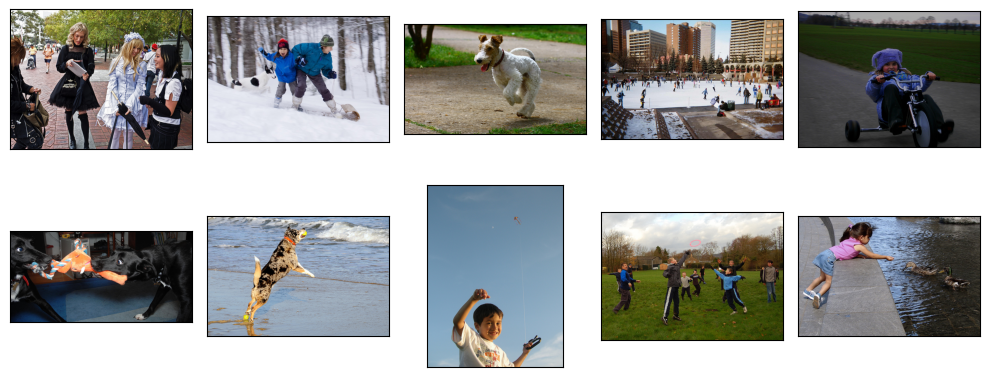

In [27]:
samples_data = list(data_test_queries['image'].sample(10))

fig = plt.figure(figsize=(10, 10))
for i in range(10):
    fig.add_subplot(5, 5, i+1)
    image = Image.open(Path(TEST_IMAGE_FOLDER, samples_data[i]))    
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

<b>Выводы</b>

Ознакомились с загруженеными данными.

Есть предобработанные файлы с сочетаниями описаний и картинок, для тренировочных и етстовых данных.

Есть экспертные оценки 5822 шт и оценки сделанные обуычными людьми  47830 шт.

На тренировочной модели есть описания картинок под номером 2, на тестовых данных дано по пять описаний.

# Шаг 2. Подготовьте данные к обучению модели

Сделаем агрегацию оценки экспертов.

Если оценки разные, то будем усреднять оценку в диапазоне от 0 до 1. 

Если будут несколько одинковых оценок, то выберем наибольшее значение.

In [28]:
def expert_aggregate(row):

    if row['first'] != row['second'] != row['third']:
        result = (row['first'] + row['second'] + row['third'] - 3) / 3 / 3
    else:
        result = (max(set([row['first'], row['second'], row['third']]), 
                                   key = [row['first'], row['second'], row['third']].count) - 1) / 3
        
    row['expert_score'] = result 
    
    
    return row

In [29]:
data_expert_annotations = data_expert_annotations.apply(expert_aggregate, axis=1)

In [30]:
data_expert_annotations.head()

,image,query_id,first,second,third,expert_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,0.000000
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,0.000000
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,0.333333
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,0.000000


Для тех картинок, которые имеют оценки от экспертов и от простых людей сделаем объединение.

In [31]:
def score_aggregate(row):
   
    if np.isnan(row['expert_score']):
        result = row['share_pos']
    elif np.isnan(row['share_pos']):
        result = row['expert_score']
    else:
        result = row['expert_score'] * 0.7 + row['share_pos'] * 0.3

    row['score'] = result
    
    return row

In [32]:
data_scores = pd.merge(data_expert_annotations, data_crowd_annotations, how='outer', on=['image', 'query_id'])

In [33]:
data_scores = data_scores.apply(score_aggregate, axis=1)

In [34]:
display(data_scores['score'].isna().value_counts())
data_scores['score'].describe()

score
False    51323
Name: count, dtype: int64

count    51323.000000
mean         0.075967
std          0.208417
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: score, dtype: float64

Добавим цели в наши датасеты.

In [35]:
data_train = pd.merge(data_train, data_scores[['image', 'query_id', 'score']], how='outer', on=['image', 'query_id'])

In [36]:
data_train_notna = data_train[data_train['query_text'].notna()]

Заполним пропуски в описании после добавления оценок людей.

In [37]:
def fill_query_text(row):

    if pd.isnull(row['query_text']):
        
        texts = data_train_notna[data_train_notna['query_id'] == row['query_id']]['query_text']
        
        if len(texts) > 0:
            row['query_text'] = texts.iloc[0]

    return row

In [38]:
data_train = data_train.apply(fill_query_text, axis=1)

In [39]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   query_text  50214 non-null  object 
 3   score       51323 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.6+ MB


Уберём те записи у которых не заполнен query_text.

In [40]:
data_train.dropna(inplace=True)
data_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50214 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       50214 non-null  object 
 1   query_id    50214 non-null  object 
 2   query_text  50214 non-null  object 
 3   score       50214 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.9+ MB


Подготовили данные. Переходим к заданию:

1. Создайте список слов которые, по вашему мнению, могут попадать под юридические ограничения.
2. Исключите из обучающего датасета пары, которые, исходя из подготовленного вами списка слов, могут попадать под юридические ограничения.

Очистим, токенизируем и лемматизируем текст, для более лёгкого поиска запросов связанные с детьми. Отметим в обучающем наборе фото подлежащие блокировке.

In [41]:
lemmatizer = WordNetLemmatizer()

In [42]:
def lemmatizing(text):
    
    text = re.sub('[^a-zA-Z]', ' ', text).lower()
    
    text = nltk.word_tokenize(text, language = 'english')
    
    text = [lemmatizer.lemmatize(word) for word in text] 

    return text

In [43]:
def cleaning(row) :

    text = lemmatizing(row['query_text'])    
    
    if [i for i in text if i in BLOCK]:
        row['blocked'] = 1
    else:
        row['blocked'] = 0

    return row

In [44]:
data_train = data_train.apply(cleaning, axis=1)

Выведем рандомный список заблокированных текстов

In [45]:
print(data_train[data_train['blocked'] == 1]['query_text'].sample(10).unique())

['A young girl is sliding down a slide at a playground .'
 'The kid is on a float in the snow .'
 'Kids playing in the water in front of a wooden bridge .'
 'two girls dress up for halloween .'
 'Two kids ride their bikes by the ocean , in the evening .'
 'A young girl in a white dress watches bubbles while a woman and girl toddler observe .'
 'A young child wearing a mask at Ivars .'
 'A little boy being splashed by water on his head'
 'A boy , wearing a baseball cap , jumps in the air near some steps .']


Посмотрим на картинки, которые отменчены как заблокированные

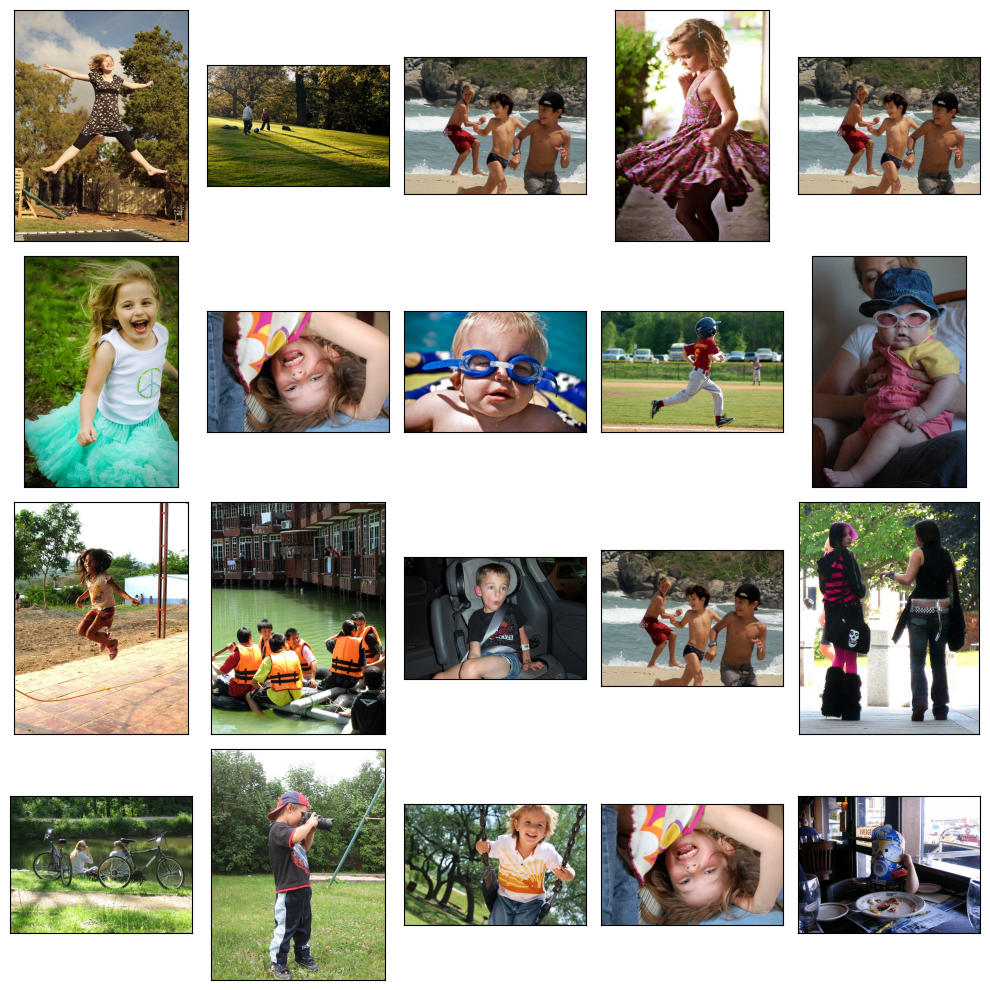

In [46]:
samples = list(data_train[data_train['blocked'] == 1]['query_id'].sample(20))
samples = [i[:-2] for i in samples]

fig = plt.figure(figsize=(10,10))
for i in range(20):
    fig.add_subplot(4, 5, i+1)
    image = Image.open(Path(TRAIN_IMAGE_FOLDER, samples[i]))
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

Удалим заблокированные данные из тренировочной выборки.

In [47]:
data_train.drop(data_train[data_train['blocked'] == 1].index, inplace=True, errors='ignore')
data_train.drop(columns='blocked', inplace=True, errors='ignore')
data_train.reset_index(inplace=True, drop=True)

In [48]:
data_train.head()

,image,query_id,query_text,score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.0
1,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,"A woman wearing black clothes , a purple scarf...",0.0
2,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,An older woman with blond hair rides a bicycle...,0.0
3,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,A woman wearing a white glove peers over the c...,0.0
4,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,A man taking a picture with a silver camera .,0.0


In [49]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36125 entries, 0 to 36124
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       36125 non-null  object 
 1   query_id    36125 non-null  object 
 2   query_text  36125 non-null  object 
 3   score       36125 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.1+ MB


In [50]:
data_test_queries.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


In [51]:
data_test_queries.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


<b>3. Сделаем векторизацию текстового описания с помощью BERT.</b>

In [52]:
bert = transformers.BertModel.from_pretrained('bert-base-uncased')

In [53]:
tokenizer = transformers.BertTokenizer.from_pretrained('bert-base-uncased')

In [54]:
def vectorize_text(model, text, tokenizer=tokenizer, batch_size=32): 

    tokenized = text.apply(
              lambda x: tokenizer.encode(
                     x, add_special_tokens=True, 
                     max_length=128, truncation=True))
    
    max_len = max([len(i) for i in tokenized.values])
    
    padded = np.array([i + [0]*(max_len - len(i)) for i in tokenized.values])
    
    attention_mask = np.where(padded != 0, 1, 0)

    embeddings = []
    for i in tqdm(range(padded.shape[0] // batch_size + 1)):
       
        batch = torch.LongTensor(padded[batch_size*i:batch_size*(i+1)])
        attention_mask_batch = torch.LongTensor(attention_mask[batch_size*i:batch_size*(i+1)])

        with torch.no_grad():
            batch_embeddings = model(batch, attention_mask=attention_mask_batch)

        embeddings.append(batch_embeddings[0][:,0,:].numpy())   
    
    return np.concatenate(embeddings)    

In [55]:
text = data_train['query_text']

In [56]:
text_embeds = vectorize_text(bert, text)

100%|██████████| 1129/1129 [06:35<00:00,  2.85it/s]


In [57]:
text_embeds.shape

(36125, 768)

<b>4. Сделаем векторизацию изображений с использованием модели ResNet50 из библиотеки Keras или PyTorch.</b>

In [58]:
def load_gen_data(dataframe=data_train, directory=TRAIN_IMAGE_FOLDER):
       
    train_datagen = ImageDataGenerator(rescale=1/255.)
    
    train_gen_flow = train_datagen.flow_from_dataframe(
        dataframe=dataframe,
        directory=Path(directory),        
        x_col='image',
        y_col='score',
        target_size=(256, 256),
        batch_size=16,
        class_mode='input',
        seed=RANDOM_STATE)
    
    return train_gen_flow

In [59]:
def create_model():

    optimizer = Adam(1e-4)
    
    backbone = ResNet50(input_shape=(256, 256, 3), weights='imagenet', include_top=False)
    
    model = Sequential()
    
    model.add(backbone)
    
    model.add(GlobalAveragePooling2D())
    
    model.compile(optimizer=optimizer, loss='mean_squared_error', metrics=['mean_absolute_error'])
    
    return model

In [60]:
model = create_model()

In [61]:
%%time

pict_embeds = model.predict(load_gen_data(data_train, TRAIN_IMAGE_FOLDER))

Found 36125 validated image filenames.
2258/2258 ━━━━━━━━━━━━━━━━━━━━ 820s 363ms/step
CPU times: total: 3h 25min 19s
Wall time: 13min 44s


In [62]:
pict_embeds.shape

(36125, 2048)

Объединеним векторы

In [63]:
X = np.concatenate((pict_embeds, text_embeds), axis=1)
X.shape

(36125, 2816)

In [64]:
y = np.array(data_train['score'])
y.shape

(36125,)

# Шаг 3. Обучите модель

В качестве метрики мы выберем RMSE (корень из среднеквадратичной ошибки), так как она симметрична относительно знака ошибки и чувствительна к большим отклонениям.

In [65]:
gss = GroupShuffleSplit(n_splits=1, train_size=.8, random_state=RANDOM_STATE)
train_indices, test_indices = next(gss.split(X, y, groups=data_train['image']))

In [66]:
X_train, X_test = X[train_indices], X[test_indices]

In [67]:
y_train, y_test = y[train_indices], y[test_indices]

In [68]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [69]:
result_data = []

<b>LinearRegression</b>

In [70]:
model = LinearRegression()

In [71]:
param_grid = {
    'fit_intercept': [True, False]
}

In [72]:
grid_cv = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_root_mean_squared_error', n_jobs=-1, verbose=2)

In [73]:
grid_cv.fit(X_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=LinearRegression(), n_jobs=-1,
             param_grid={'fit_intercept': [True, False]},
             scoring='neg_root_mean_squared_error', verbose=2)

In [74]:
result_data.append(['LinearRegression', -round(grid_cv.best_score_, 2), grid_cv])

<b>DummyRegressor</b>

In [75]:
model = DummyRegressor()

In [76]:
param_grid = {
    'strategy': ['median']
}

In [77]:
grid_cv = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_root_mean_squared_error', n_jobs=-1, verbose=2)

In [78]:
grid_cv.fit(X_train, y_train)

Fitting 3 folds for each of 1 candidates, totalling 3 fits


GridSearchCV(cv=3, estimator=DummyRegressor(), n_jobs=-1,
             param_grid={'strategy': ['median']},
             scoring='neg_root_mean_squared_error', verbose=2)

In [79]:
result_data.append(['DummyRegressor', -round(grid_cv.best_score_, 2), grid_cv])

<b>LinearSVR</b>

In [80]:
model = LinearSVR(random_state=RANDOM_STATE)

In [81]:
param_grid = {
    'loss' : ['squared_epsilon_insensitive'],
    'C' : [1]
}

In [82]:
grid_cv = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_root_mean_squared_error', n_jobs=-1, verbose=2)

In [83]:
grid_cv.fit(X_train, y_train)

Fitting 3 folds for each of 1 candidates, totalling 3 fits


GridSearchCV(cv=3, estimator=LinearSVR(random_state=42), n_jobs=-1,
             param_grid={'C': [1], 'loss': ['squared_epsilon_insensitive']},
             scoring='neg_root_mean_squared_error', verbose=2)

In [84]:
result_data.append(['LinearSVR', -round(grid_cv.best_score_, 2), grid_cv])

<b>LGBMRegressor</b>

In [85]:
model = LGBMRegressor(metric='rmse', n_jobs=-1, verbosity=-1, random_state=RANDOM_STATE)

In [86]:
param_grid = {
    'max_depth':[-1, 10, 20],
    'num_leaves':[10, 31],
    'learning_rate':[.1, .5]
}

In [87]:
grid_cv = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_root_mean_squared_error', n_jobs=-1, verbose=2)

In [88]:
grid_cv.fit(X_train, y_train)

Fitting 3 folds for each of 12 candidates, totalling 36 fits


GridSearchCV(cv=3,
             estimator=LGBMRegressor(metric='rmse', n_jobs=-1, random_state=42,
                                     verbosity=-1),
             n_jobs=-1,
             param_grid={'learning_rate': [0.1, 0.5], 'max_depth': [-1, 10, 20],
                         'num_leaves': [10, 31]},
             scoring='neg_root_mean_squared_error', verbose=2)

In [89]:
result_data.append(['LGBMRegressor', -round(grid_cv.best_score_, 2), grid_cv])

<b>NeuralNetwork</b>

In [90]:
X.shape

(36125, 2816)

In [91]:
model = Sequential()

model.add(Dense(2816, input_shape=(2816,), activation='relu'))
model.add(BatchNormalization())
model.add(Dense(256, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(1, activation='relu'))

model.compile(optimizer=Adam(learning_rate=1e-5), loss='mean_squared_error', metrics=['accuracy'])

model.build()
model.summary()

model.fit(X_train, y_train, validation_data=(X_test, y_test), batch_size=32, epochs=10, shuffle=True, verbose=2)

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 2816)           │     7,932,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 2816)           │        11,264 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       721,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,666,369 (33.06 MB)

 Trainable params: 8,660,225 (33.04 MB)

 Non-trainable params: 6,144 (24.00 KB)

Epoch 1/10
903/903 - 33s - 36ms/step - accuracy: 0.6746 - loss: 0.2186 - val_accuracy: 0.7661 - val_loss: 0.1103
Epoch 2/10
903/903 - 31s - 34ms/step - accuracy: 0.8010 - loss: 0.0706 - val_accuracy: 0.7899 - val_loss: 0.0857
Epoch 3/10
903/903 - 32s - 36ms/step - accuracy: 0.8377 - loss: 0.0429 - val_accuracy: 0.8000 - val_loss: 0.0778
Epoch 4/10
903/903 - 32s - 35ms/step - accuracy: 0.8441 - loss: 0.0348 - val_accuracy: 0.8047 - val_loss: 0.0737
Epoch 5/10
903/903 - 31s - 35ms/step - accuracy: 0.8447 - loss: 0.0339 - val_accuracy: 0.8139 - val_loss: 0.0681
Epoch 6/10
903/903 - 32s - 35ms/step - accuracy: 0.8440 - loss: 0.0354 - val_accuracy: 0.8182 - val_loss: 0.0640
Epoch 7/10
903/903 - 32s - 35ms/step - accuracy: 0.8446 - loss: 0.0355 - val_accuracy: 0.8222 - val_loss: 0.0624
Epoch 8/10
903/903 - 31s - 35ms/step - accuracy: 0.8439 - loss: 0.0356 - val_accuracy: 0.8230 - val_loss: 0.0644
Epoch 9/10
903/903 - 31s - 35ms/step - accuracy: 0.8451 - loss: 0.0346 - val_accuracy: 0.8302 - 

In [92]:
predict = model.predict(X_test)
mse_result = mean_absolute_error(y_test, predict)
result_data.append(['NeuralNetwork', round(mse_result, 2), model])

227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


<b>Итоговый результат</b>

In [93]:
result_data_df = pd.DataFrame(   
    data=result_data,
    columns=['model', 'RMSE', 'grid']
)

In [94]:
result_data_df.sort_values(by=['RMSE'], ascending=True)

,model,RMSE,grid
4,NeuralNetwork,0.10,"<Sequential name=sequential_1, built=True>"
3,LGBMRegressor,0.22,"GridSearchCV(cv=3,\n estimator=LGB..."
0,LinearRegression,0.23,"GridSearchCV(cv=3, estimator=LinearRegression(..."
2,LinearSVR,0.23,"GridSearchCV(cv=3, estimator=LinearSVR(random_..."
1,DummyRegressor,0.24,"GridSearchCV(cv=3, estimator=DummyRegressor(),..."


# Шаг 4. Тестирование модели и демонстрация ее работы

Возьмём NeuralNetwork, т.к. у неё самый минимальный RMSE = 0.1.

Для тестирования модели получим эмбединги для всехтестовых изображений из тестовой папки. Выберем двадцать случайних запросов и для каждого запроса выведем наиболее релевантное изображение, и сравним качестов поиска.

In [95]:
res_data = result_data_df.sort_values(by=['RMSE'], ascending=True).values[0]
best_model = res_data[2]

In [96]:
def load_test_data(path=TEST_IMAGE_FOLDER):
    
    train_datagen = ImageDataGenerator(rescale=1/255.)
    train_gen_flow = train_datagen.flow_from_dataframe(
        dataframe=data_test,
        directory=Path(TEST_IMAGE_FOLDER),        
        x_col='image',
        y_col=None,
        target_size=(256, 256),
        batch_size=16,
        class_mode='input',
        seed=RANDOM_STATE)
    
    return train_gen_flow

In [97]:
%%time

model = create_model()

pict_embeds_test = model.predict(load_test_data(TEST_IMAGE_FOLDER))

Found 100 validated image filenames.
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 632ms/step
CPU times: total: 36.9 s
Wall time: 6.56 s


Функция для обработки текстовых запросов из тестовой выборки.

In [99]:
def vectorize_input_text(model, text, tokenizer=tokenizer):   
    
    tokenized = tokenizer(text, return_tensors="pt", add_special_tokens=True, max_length=128, truncation=True)  
    
    with torch.no_grad():
        outputs = model(**tokenized)
        last_hidden_states = outputs.last_hidden_state
    
    embedding = last_hidden_states.mean(dim=1)
    
    return  embedding

Функция для получения наиболее схожего с описанием изображения: функция принимает на вход текстовое описание, делает его векторизацию и возвращает картинку с максимальным значением метрики.

In [101]:
def get_picture(text):
   
    if [i for i in lemmatizing(text) if i in BLOCK]:
        print('-' * 100)
        print()
        print(text)
        print()
        print('#' * 77)
        s = 'This image is unavailable in your country in compliance with local laws'.upper()
        print(f'## {s} ##')
        print('#' * 77)
        print()
    else:
        
        text_embed = vectorize_input_text(model=bert, text=[text])        
        
        X = np.concatenate((pict_embeds_test, np.resize(text_embed, (pict_embeds_test.shape[0], text_embeds.shape[1]))), axis=1)
        X = scaler.transform(X)
        predictions = best_model.predict(X)        
        df = pd.concat((data_test, pd.Series(np.reshape(predictions, (predictions.shape[0],)), name='pred')), axis=1) 
        top = list(df.sort_values(by='pred', ascending=False)['image'].head(10)) 
        top_score = list(df.sort_values(by='pred', ascending=False)['pred'].head(10))

        print()
        print(text)
        print()        

        fig = plt.figure(figsize=(5, 5))
        
        if text in list(data_test_queries['query_text']):
            plt.rcParams['axes.edgecolor'] = 'red'
            plt.rcParams['axes.linewidth'] = 10
            fig.add_subplot(1, 1, 1)
            image = Image.open(Path(TEST_IMAGE_FOLDER, data_test_queries.iloc[data_test_queries[data_test_queries['query_text'] == text].index[0]]['image']))
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()

        fig = plt.figure(figsize=(15, 5))
        
        plt.rcParams['axes.edgecolor'] = 'black'
        plt.rcParams['axes.linewidth'] = 0
        for i in range(10):
            fig.add_subplot(2, 5, i+1, title=round(top_score[i], 2))
            image = Image.open(Path(TEST_IMAGE_FOLDER, top[i]))
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()
            
        plt.show()

        print('-' * 100)

Выберем двадцить случайных запросов из файла с тестовыми запросами и посмотрим на результат работы функции.

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 

People are watching a race car speed thorugh the dirt .



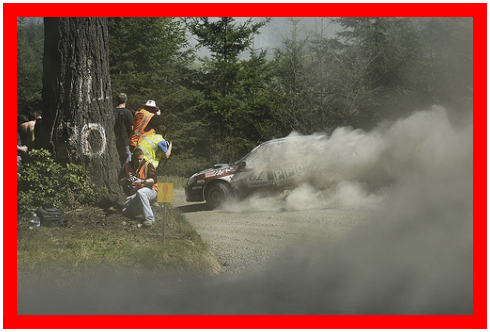

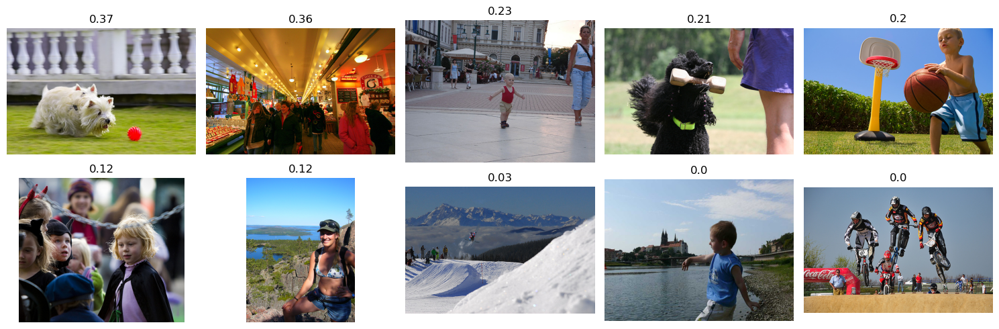

----------------------------------------------------------------------------------------------------
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

Men in a khaki-colored tent outside in a rundown area .



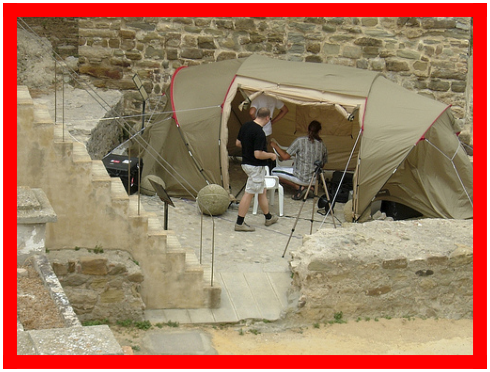

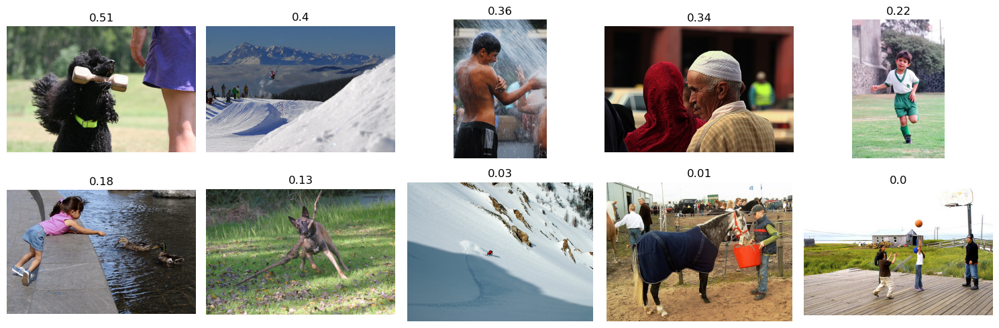

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

Young boys enjoying a spray of water .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

----------------------------------------------------------------------------------------------------

a boy flings sand at a girl .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

Two small white dogs are in a yard chasing a red ball .



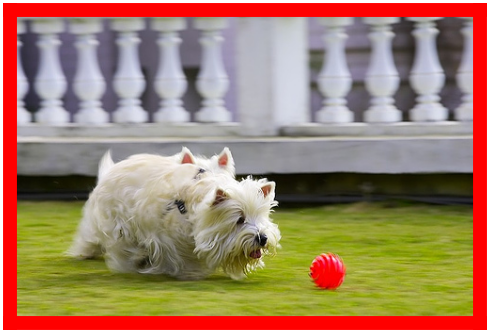

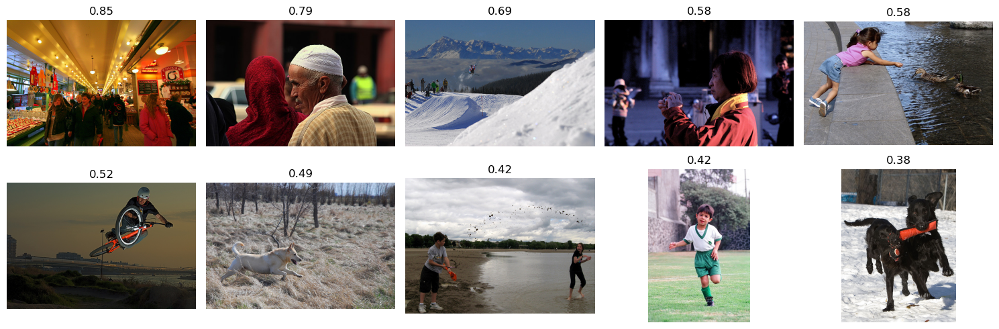

----------------------------------------------------------------------------------------------------
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

The shoppers are walking in a store .



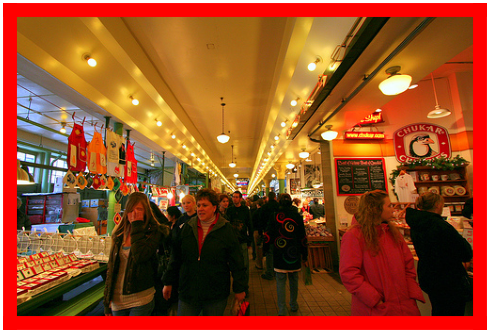

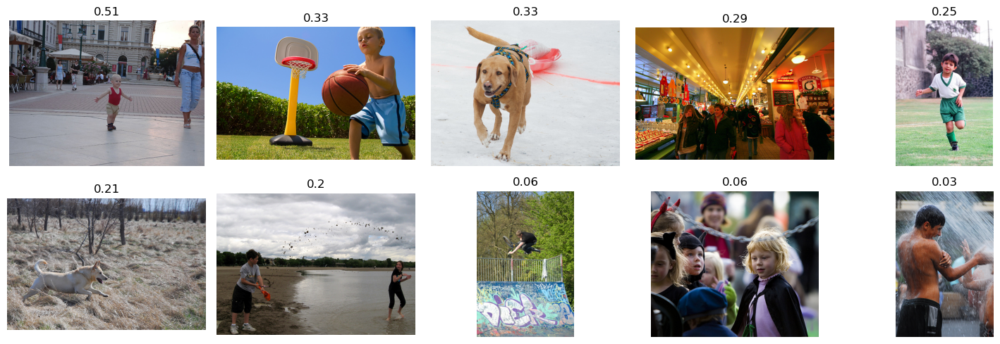

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

A woman is throwing a bucket of water over a baby in the paddling pool .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

A black and white dog jumping out of the water and a brown dog shaking off .



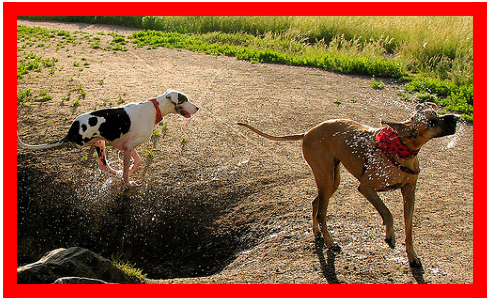

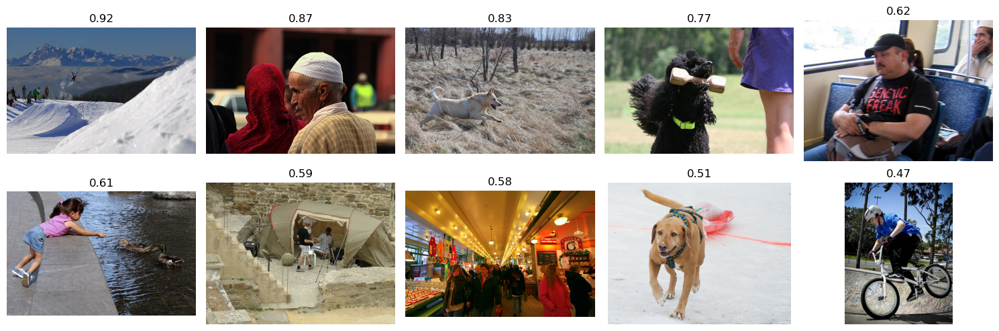

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

A girl on skis in snow .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

----------------------------------------------------------------------------------------------------

Kids in bathing suits with water splashing around them .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 

A group of women wearing red all rally together .



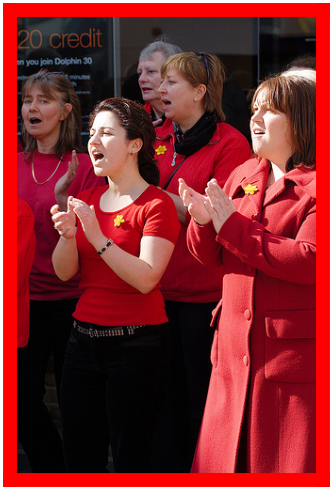

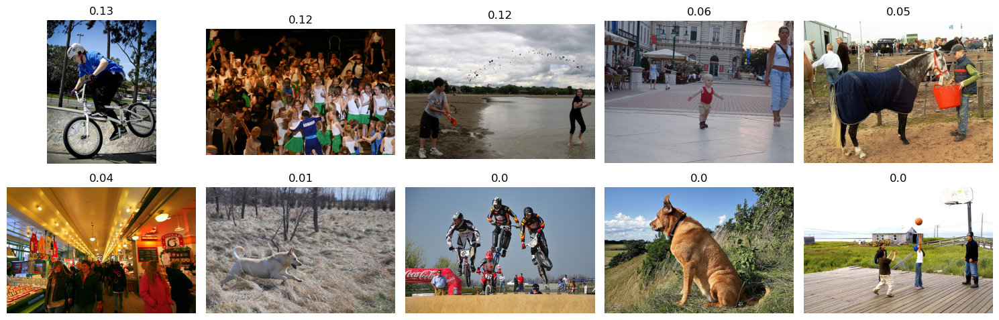

----------------------------------------------------------------------------------------------------
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 

A man , seen from the back , with his head turned to the side wearing a backpack



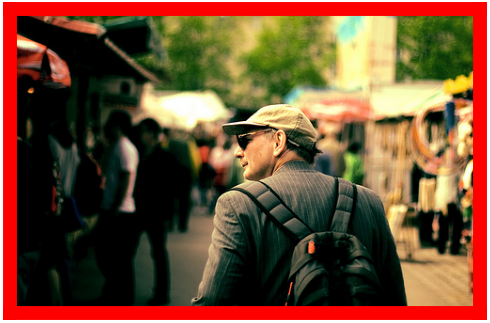

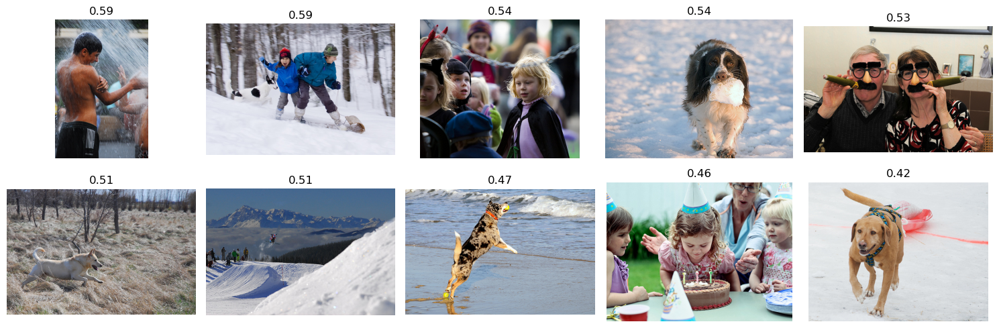

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

Boys and girls at a party .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 

Several female lacrosse players are going after a ball .



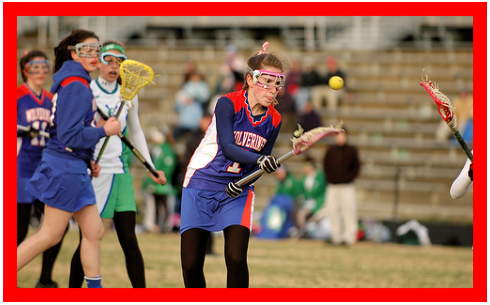

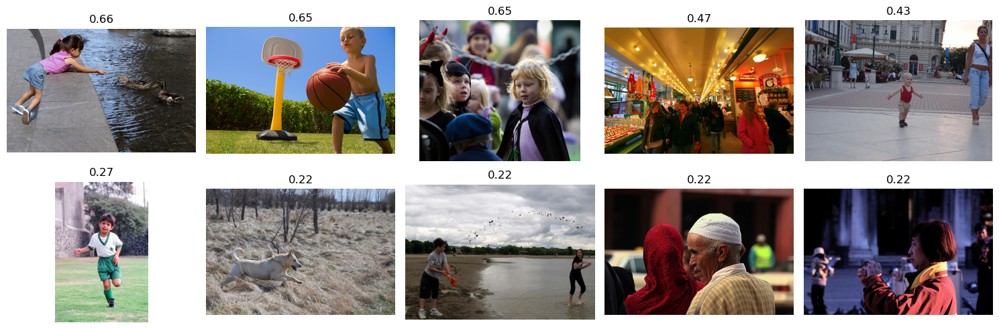

----------------------------------------------------------------------------------------------------
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

An outdoor ice skating rink full of people .



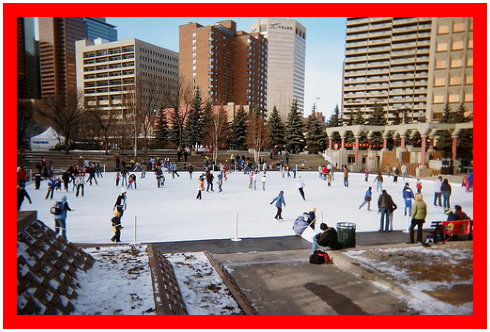

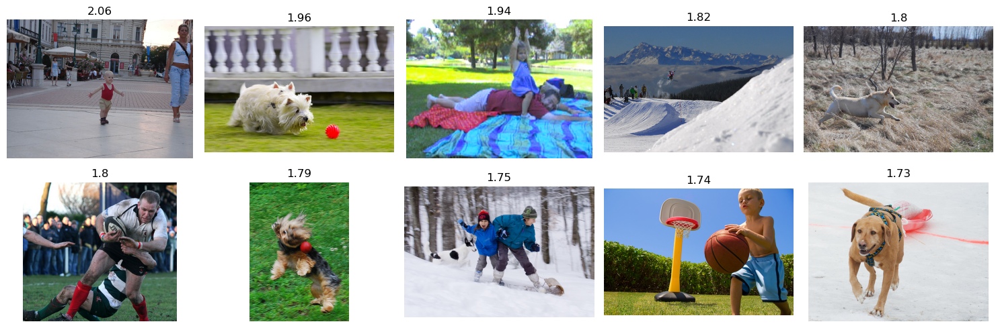

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

The young boy flings mud at the barefoot girl in the pond .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

----------------------------------------------------------------------------------------------------

A young girl is smiling in front of the camera at a park .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

A brown and white dog is carrying a snowball .



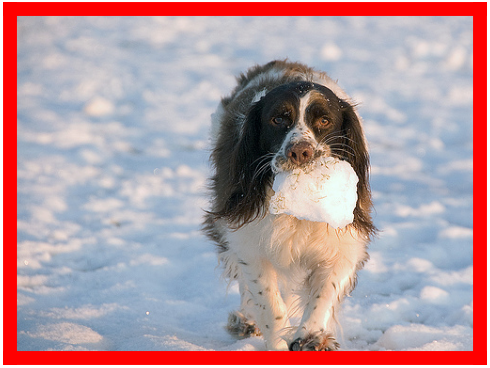

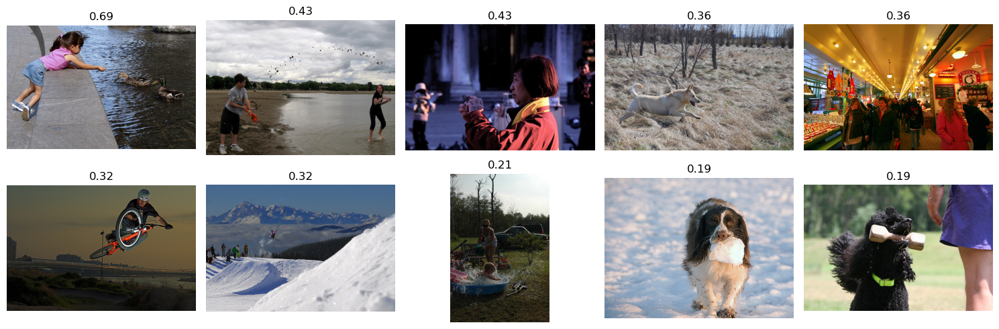

----------------------------------------------------------------------------------------------------
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

A shirtless man wearing a vest walks on a stage with his arms up .



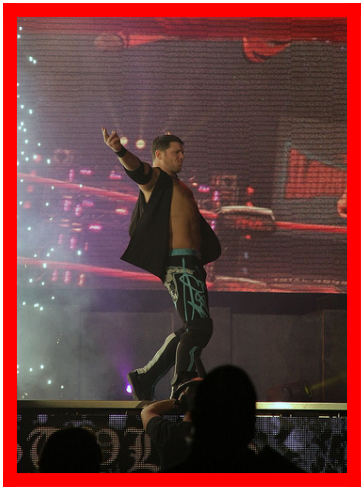

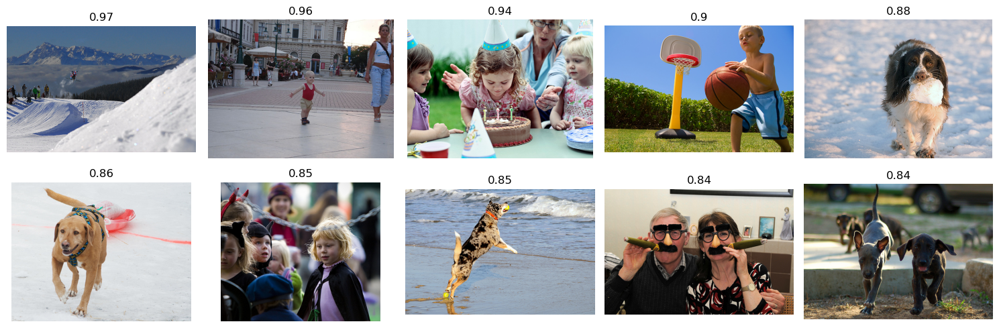

----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

A playground with two children and an adult .

#############################################################################
## THIS IMAGE IS UNAVAILABLE IN YOUR COUNTRY IN COMPLIANCE WITH LOCAL LAWS ##
#############################################################################



In [102]:
samples = data_test_queries.sample(20)
text_test = list(samples['query_text'])

for text in text_test:
    get_picture(text)

<b>Вывод</b>

- Протестировали лучшую модель — NeuralNetwork Keras:
- Получили эмбеддинги для тестовых изображений и описаний.
- Сформировали двадцать случайных описаний и нашли и сравнили десять, определенных моделью изображений, наиболее подходящих под каждое описание.
- Схема работает, но судя по выведенным по описаниям фотографиям модель не всегда попадает в точку.

# Шаг 5. Сделайте общий вывод по работе

В рамках проекта была создана и протестирована демонстрационная версия для системы поиска изображений по описанию.

В ходе работы над проектом выполнено:

- Загружены данные и провели их исследовательский анализ.
- Объеденены оценки экспертов и краудсорсеров.
- Исключены из датасета объекты, которые выходят за рамки юридических ограничений.
- Векторизованы изображения с помощью ResNet50 и текстовые описания — с Bert base uncased.
- Объеденины векторы изображений и текстов.
- Разделены данные на обучающую и валидационную выборки.
- Выбраны модели и метрика оценки качества их работы (RMSE).
- Обучены модели и выбрана лучшая.
- Протестирована лучшая модель с помощью функции, которая по текстовому описанию возвращает изображение с максимальным значением метрики.
- Протестирована работа модели на нескольких текстовых запросах.
- Сформулированы и оформлены промежуточный и общий выводы.

Резюме:

Модель показывает неидеальную стабильность с точки зрения предоставления релевантных результатов. В выдачу не всегда попадает верное изображение, но чуть чаще попадают фотографии связанные тематически. Данный датасет слишком мал для эффективного поиска дополнительных изображений. Модель нуждается в расширении датасета для улучшения ее качества. Дополнительно данные позволят модели обучиться более эффективно и дать более качественные результаты.